# nuScenes devkit tutorial

Welcome to the nuScenes tutorial. This demo assumes the database itself is available at `/data/sets/nuscenes`, and loads a mini version of the full dataset.

## A Gentle Introduction to nuScenes

이 튜토리얼의 이 부분에서는 데이터베이스의 최상위 소개를 살펴보겠습니다. 저희 데이터셋은 다음과 같은 기본 구성 요소로 이루어져 있습니다:

1. `log` - 데이터가 추출된 로그 정보.
2. `scene`- 자동차 여정의 20초 스니펫.
3. `sample` - 특정 타임스탬프에서 장면의 주석이 달린 스냅샷.
4. `sample_data` - 특정 센서에서 수집한 데이터.
5. `ego_pose` - 특정 타임스탬프에서의 자기 차량 위치.
6. `sensor` - 특정 센서 유형.
7. `calibrated sensor` - 특정 차량에서 캘리브레이션된 특정 센서의 정의.
8. `instance` - 관찰한 모든 물체 인스턴스의 열거.
9. `category` - 물체 범주의 분류 (예: 차량, 인간).
10. `attribute` - 범주는 동일한 상태로 유지되지만 인스턴스의 속성이 변경될 수 있는 것.
11. `visibility` - 6개의 다른 카메라에서 수집한 모든 이미지의 가시성을 픽셀로 표시한 것의 분수.
12. `sample_annotation` - 우리의 관심 대상인 객체의 주석이 달린 인스턴스.
13. `map` - 위에서 본 시각에서의 이진 의미론적 마스크로 저장된 지도 데이터.

The database schema is visualized below. For more information see the [nuScenes schema](https://github.com/nutonomy/nuscenes-devkit/blob/master/docs/schema_nuscenes.md) page.
![](https://www.nuscenes.org/public/images/nuscenes-schema.svg)


데이터베이스 스키마는 아래에서 시각화되어 있습니다. 자세한 정보는 nuScenes schema 페이지를 참조하십시오.

## Google Colab (optional)

<br>
<a href="https://colab.research.google.com/github/nutonomy/nuscenes-devkit/blob/master/python-sdk/tutorials/nuscenes_tutorial.ipynb">
    <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab" align="left">
</a>
<br>

If you are running this notebook in Google Colab, you can uncomment the cell below and run it; everything will be set up nicely for you. Otherwise, manually set up everything.

In [2]:
# !mkdir -p /data/sets/nuscenes  # Make the directory to store the nuScenes dataset in.

# !wget https://www.nuscenes.org/data/v1.0-mini.tgz  # Download the nuScenes mini split.

# !tar -xf v1.0-mini.tgz -C /data/sets/nuscenes  # Uncompress the nuScenes mini split.

!pip install nuscenes-devkit &> /dev/null  # Install nuScenes.

## Initialization

In [1]:
%matplotlib inline
from nuscenes.nuscenes import NuScenes

# self.table_names = ['category', 'attribute', 'visibility', 'instance', 'sensor', 'calibrated_sensor',
#                    'ego_pose', 'log', 'scene', 'sample', 'sample_data', 'sample_annotation', 'map']

# json file load
nusc = NuScenes(version='v1.0-test', dataroot='./data/nuscenes/v1.0-test', verbose=True)

Loading NuScenes tables for version v1.0-test...
23 category,
8 attribute,
4 visibility,
0 instance,
12 sensor,
1800 calibrated_sensor,
462901 ego_pose,
15 log,
150 scene,
6008 sample,
462901 sample_data,
0 sample_annotation,
4 map,
Done loading in 3.734 seconds.
Reverse indexing ...
Done reverse indexing in 0.4 seconds.


In [33]:
# nusc.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=5, underlay_map=False)

import json

with open('./output/results_nusc.json','r') as f:
    data = json.load(f)
    
nusc_result = data
# keys : 'results', 'meta' // len = 6019, 5


# len = 6019
# dict_keys(['name', 'score', 'boxes_lidar', 'pred_labels', 'frame_id', 'metadata'])
# import pickle

# with open('./output/result.pkl','rb') as fr:
#     data = pickle.load(fr)
# print(data[0].keys())

print(len(nusc_result['results']))

6008


In [60]:
nusc_result['results']

# '''
# sample_token은 동일함 
# sample_token : [predicted sample number만큼의 dictionary]
# dict_keys(['sample_token', 'translation', 'size', 'rotation', 'velocity', 'detection_name', 'detection_score', 'attribute_name'])

# {'1b9a789e08bb4b7b89eacb2176c70840': [{'sample_token': '1b9a789e08bb4b7b89eacb2176c70840',
#    'translation': [2388.7809031382203, 786.3267748208597, 0.8519953734404484],
#    'size': [1.872794508934021, 4.520198822021484, 1.7588486671447754],
#    'rotation': [-0.7406528155050123,
#     -0.03299902570821236,
#     0.0005136139249104013,
#     0.671076901247199],
#    'velocity': [-3.42064921242407e-09, 4.468089344445701e-09],
#    'detection_name': 'car',
#    'detection_score': 0.7736384868621826,
#    'attribute_name': 'vehicle.parked'},
# '''

{'1b9a789e08bb4b7b89eacb2176c70840': [{'sample_token': '1b9a789e08bb4b7b89eacb2176c70840',
   'translation': [2388.7809031382203, 786.3267748208597, 0.8519953734404484],
   'size': [1.872794508934021, 4.520198822021484, 1.7588486671447754],
   'rotation': [-0.7406528155050123,
    -0.03299902570821236,
    0.0005136139249104013,
    0.671076901247199],
   'velocity': [-3.42064921242407e-09, 4.468089344445701e-09],
   'detection_name': 'car',
   'detection_score': 0.7736384868621826,
   'attribute_name': 'vehicle.parked'},
  {'sample_token': '1b9a789e08bb4b7b89eacb2176c70840',
   'translation': [2385.894681377552, 805.0040185912926, 1.3407688624567975],
   'size': [1.956553339958191, 4.628422737121582, 1.7301779985427856],
   'rotation': [0.699177769079522,
    0.03297064486176032,
    0.0014615315100261865,
    -0.7141857235537734],
   'velocity': [0.0067889104842815745, -0.5285255261625349],
   'detection_name': 'car',
   'detection_score': 0.7261371612548828,
   'attribute_name': 've

In [54]:
sample_tokens = [s['token'] for s in nusc.sample]
print(len(sample_tokens)) #6008
print(len(nusc_result['results'].keys())) #6008


6008
6008


6008
['1b9a789e08bb4b7b89eacb2176c70840', 'fdcf214ba54b4241a12529a9d81d051c', '1c05e9f2e6364d2c8ceb0ff2f0f72fdb', '56303112f37244bbbd0a1e0ee012b9bc', '02fd302178dd44568ae305320ea24054', 'd93f021fc031411c9a35bf08917cedd7', 'e866142822bb421d87d8f9bd1b91fbc3', 'c0be823ae8f040e2b3306002c571ae57', 'f32d3a2842004926b41985152fa1bfad', 'fe593d6fc5d146ebb7fc9e2729f80b89', '6b7b3ca659874b5caa93b800a3739af6', 'eef8fcdda74f45b9843d7b4364cf0ce9', 'd9db2d0140f74a2b9cb71b1b35297d14', '21c319c7b99341e8a2f6678ba811afb1', 'f7b91a55e3bc425d8e35fbef96075868', '584968ff11a44557abc9f15cad4cfbc4', '2594f9ed965d4cf3842a06ffcc0b5c92', '384d9da6b1fc46f884c87363ceab945b', 'ce2a1fbb0e6d404387302a91b8362286', 'd623151a2f6a43bcb94bf40ae081ce66', 'fd3a54c554354b74b093682e77e90d9b', '231dae67c3894ab7a97e0a0cb5f4c728', '17f0bf3f057344168e95ca9bef2c8269', '9f3b6c705d454225ab9cf31e3c6f3055', 'bebf3ac7bd8042b694bde92bbe69bf23', '1ce7b8924b864e66a0151a2947eb999b', '63ff91b4a82d448d9171e056d1c2f500', 'e85e781899ce419aa40e1

KeyboardInterrupt: 

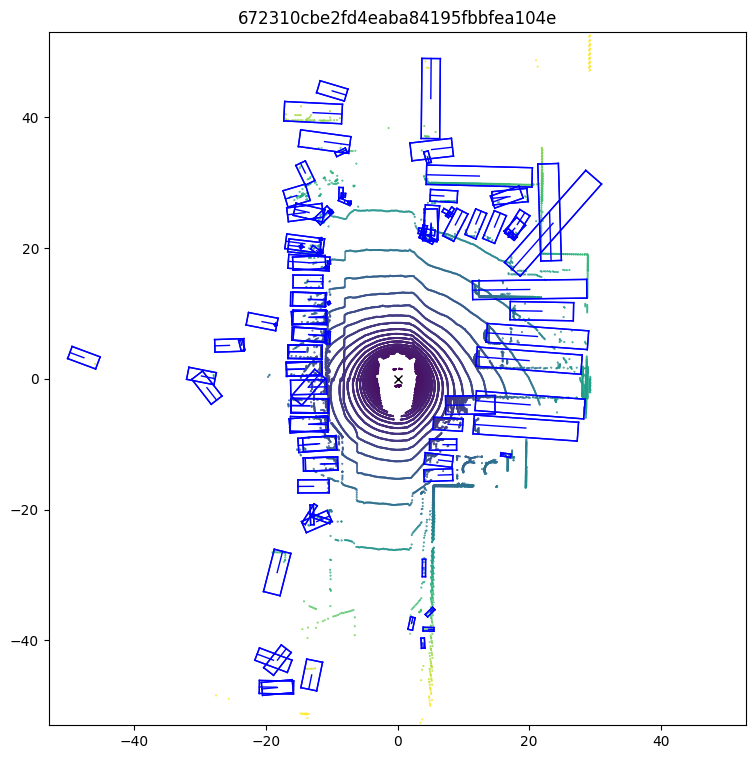

In [3]:
from nuscenes.eval.detection.render import visualize_sample
from nuscenes.eval.common.data_classes import EvalBoxes
from nuscenes.eval.detection.data_classes import DetectionBox
from nuscenes.eval.common.loaders import load_prediction, add_center_dist,filter_eval_boxes
cfg = {
  "class_range": {
    "car": 50,
    "truck": 50,
    "bus": 50,
    "trailer": 50,
    "construction_vehicle": 50,
    "pedestrian": 40,
    "motorcycle": 40,
    "bicycle": 40,
    "traffic_cone": 30,
    "barrier": 30
  },
  "dist_fcn": "center_distance",
  "dist_ths": [0.5, 1.0, 2.0, 4.0],
  "dist_th_tp": 2.0,
  "min_recall": 0.1,
  "min_precision": 0.1,
  "max_boxes_per_sample": 500,
  "mean_ap_weight": 5
}

result_path = './output/results_nusc.json'
sample_tokens = [s['token'] for s in nusc.sample]
print(len(sample_tokens))

pred_boxes, meta = load_prediction(result_path,1000, DetectionBox,verbose=False)
pred_boxes = add_center_dist(nusc, pred_boxes)
pred_boxes = filter_eval_boxes(nusc, pred_boxes, cfg['class_range'], verbose=False)
#sample_tokens = pred_boxes.sample_tokens
sample_tokens = list(sample_tokens)
print(sample_tokens)
for sample_token in sample_tokens:
    visualize_sample(nusc,sample_token, EvalBoxes(),pred_boxes,eval_range=50,savepath='./result_0.1/{}.png'.format(sample_token))


In [40]:
my_scene_token = nusc.field2token('scene', 'name', 'scene-0279')[0]
my_scene_token

#  The rendering command below is commented out because it may crash in notebooks
#nusc.render_scene_channel(my_scene_token, 'CAM_FRONT')

'712165fa210941e7bfc04de2ea083579'

## A look at the dataset

### 1. `scene`

NuScenes는 약 20초 간격으로 약 ***1000개의 장면***에서 주석이 달린 샘플을 포함하는 대규모 데이터베이스입니다. 이제 로드된 데이터베이스에 있는 장면들을 살펴보겠습니다. 

In [56]:
#list_scenes():데이터베이스에 있는 모든 장면의 정보를 나타내는 리스트를 반환합니다.
nusc.list_scenes()

scene-0279, ## No descriptions available for the te... [18-07-25 08:18:00]   19s, singapore-onenorth, #anns:0
scene-0280, ## No descriptions available for the te... [18-07-25 08:19:38]   19s, singapore-onenorth, #anns:0
scene-0281, ## No descriptions available for the te... [18-07-25 08:20:38]   19s, singapore-onenorth, #anns:0
scene-0282, ## No descriptions available for the te... [18-07-25 08:21:48]   20s, singapore-onenorth, #anns:0
scene-0307, ## No descriptions available for the te... [18-07-25 08:22:43]   19s, singapore-onenorth, #anns:0
scene-0308, ## No descriptions available for the te... [18-07-25 08:26:42]   19s, singapore-onenorth, #anns:0
scene-0140, ## No descriptions available for the te... [18-08-01 08:54:15]   19s, singapore-onenorth, #anns:0
scene-0142, ## No descriptions available for the te... [18-08-01 08:55:38]   19s, singapore-onenorth, #anns:0
scene-0143, ## No descriptions available for the te... [18-08-01 08:57:29]   19s, singapore-onenorth, #anns:0
scene-0144

Let's look at a scene metadata

In [64]:
my_scene = nusc.scene[0]
print(len(nusc.scene)) # 150개의 scenes 
print(my_scene)

# 대충 20s짜리 1씬당 40개의 sample(주석이 있는거는 0.5s 단위), 
# 총 150개의 scene이 잇으니까 6000개의 sample 위에서 sample 개수가 6008개얐으니까 대충 맞겠군 

150
{'nbr_samples': 40, 'name': 'scene-0077', 'last_sample_token': 'c51c10209bd14d5193583b195b36f2f0', 'description': '## No descriptions available for the test set. ##', 'token': 'bc6a757d637f4832be68986833ec17ac', 'log_token': 'ceb76203d8d7415f83ae3f81e112a0ca', 'first_sample_token': '1b9a789e08bb4b7b89eacb2176c70840'}


{'nbr_samples': 40,
 'name': 'scene-0081',
 'last_sample_token': '5d0c5f6c94294057b51fdbcb86cc071a',
 'description': '## No descriptions available for the test set. ##',
 'token': 'b730a92c13f7477aba6422f522f0f00d',
 'log_token': 'ceb76203d8d7415f83ae3f81e112a0ca',
 'first_sample_token': 'c65eed10964644b092a185bdcf047d3d'}

### 2. `sample`

여기서 'sample'을 ***특정 타임스탬프에서의 주석된 키프레임***으로 정의합니다. 키프레임은 모든 센서에서의 데이터의 타임스탬프가 해당 키프레임을 가리키는 샘플의 타임스탬프와 매우 가까워야 하는 프레임입니다.

이제 이 장면에서 첫 번째 주석된 샘플을 살펴보겠습니다.

In [24]:
first_sample_token = my_scene['first_sample_token']

# The rendering command below is commented out because it tends to crash in notebooks


# render_sample 함수 
# render_sample 함수의 주요 매개변수와 역할은 다음과 같습니다:

#     nusc: NuScenes 클래스의 객체로, 데이터셋을 초기화한 인스턴스입니다.
#     sample_token: 렌더링하려는 특정 샘플의 고유 토큰입니다.


#nusc.render_sample(first_sample_token)

Let's examine its metadata

In [25]:
# get(sample_token: str):
# 주어진 sample_token에 해당하는 Sample 객체를 반환합니다.

# anns 가 test에는 비어있음. token형식 

my_sample = nusc.get('sample', first_sample_token)
my_sample

{'token': 'ca9a282c9e77460f8360f564131a8af5',
 'timestamp': 1532402927647951,
 'prev': '',
 'next': '39586f9d59004284a7114a68825e8eec',
 'scene_token': 'cc8c0bf57f984915a77078b10eb33198',
 'data': {'RADAR_FRONT': '37091c75b9704e0daa829ba56dfa0906',
  'RADAR_FRONT_LEFT': '11946c1461d14016a322916157da3c7d',
  'RADAR_FRONT_RIGHT': '491209956ee3435a9ec173dad3aaf58b',
  'RADAR_BACK_LEFT': '312aa38d0e3e4f01b3124c523e6f9776',
  'RADAR_BACK_RIGHT': '07b30d5eb6104e79be58eadf94382bc1',
  'LIDAR_TOP': '9d9bf11fb0e144c8b446d54a8a00184f',
  'CAM_FRONT': 'e3d495d4ac534d54b321f50006683844',
  'CAM_FRONT_RIGHT': 'aac7867ebf4f446395d29fbd60b63b3b',
  'CAM_BACK_RIGHT': '79dbb4460a6b40f49f9c150cb118247e',
  'CAM_BACK': '03bea5763f0f4722933508d5999c5fd8',
  'CAM_BACK_LEFT': '43893a033f9c46d4a51b5e08a67a1eb7',
  'CAM_FRONT_LEFT': 'fe5422747a7d4268a4b07fc396707b23'},
 'anns': ['ef63a697930c4b20a6b9791f423351da',
  '6b89da9bf1f84fd6a5fbe1c3b236f809',
  '924ee6ac1fed440a9d9e3720aac635a0',
  '91e3608f55174a319

유용한 메서드 중 하나는 list_sample()입니다. 이 메서드는 특정 sample와 관련된 모든 sample_data 키프레임 및 sample_annotation을 나열합니다. 이를테면, 이후 부분에서 자세히 논의할 것입니다.

In [14]:
nusc.list_sample(my_sample['token'])

Sample: ca9a282c9e77460f8360f564131a8af5

sample_data_token: 37091c75b9704e0daa829ba56dfa0906, mod: radar, channel: RADAR_FRONT
sample_data_token: 11946c1461d14016a322916157da3c7d, mod: radar, channel: RADAR_FRONT_LEFT
sample_data_token: 491209956ee3435a9ec173dad3aaf58b, mod: radar, channel: RADAR_FRONT_RIGHT
sample_data_token: 312aa38d0e3e4f01b3124c523e6f9776, mod: radar, channel: RADAR_BACK_LEFT
sample_data_token: 07b30d5eb6104e79be58eadf94382bc1, mod: radar, channel: RADAR_BACK_RIGHT
sample_data_token: 9d9bf11fb0e144c8b446d54a8a00184f, mod: lidar, channel: LIDAR_TOP
sample_data_token: e3d495d4ac534d54b321f50006683844, mod: camera, channel: CAM_FRONT
sample_data_token: aac7867ebf4f446395d29fbd60b63b3b, mod: camera, channel: CAM_FRONT_RIGHT
sample_data_token: 79dbb4460a6b40f49f9c150cb118247e, mod: camera, channel: CAM_BACK_RIGHT
sample_data_token: 03bea5763f0f4722933508d5999c5fd8, mod: camera, channel: CAM_BACK
sample_data_token: 43893a033f9c46d4a51b5e08a67a1eb7, mod: camera, channel:

### 3. `sample_data`

NuScenes 데이터셋은 전체 센서 suite에서 수집한 데이터를 포함하고 있으므로 각 장면의 스냅샷에 대한 데이터 집합을 제공합니다. 이러한 데이터에 액세스하기 위해 data 키를 제공합니다.

In [15]:
my_sample['data']

{'RADAR_FRONT': '37091c75b9704e0daa829ba56dfa0906',
 'RADAR_FRONT_LEFT': '11946c1461d14016a322916157da3c7d',
 'RADAR_FRONT_RIGHT': '491209956ee3435a9ec173dad3aaf58b',
 'RADAR_BACK_LEFT': '312aa38d0e3e4f01b3124c523e6f9776',
 'RADAR_BACK_RIGHT': '07b30d5eb6104e79be58eadf94382bc1',
 'LIDAR_TOP': '9d9bf11fb0e144c8b446d54a8a00184f',
 'CAM_FRONT': 'e3d495d4ac534d54b321f50006683844',
 'CAM_FRONT_RIGHT': 'aac7867ebf4f446395d29fbd60b63b3b',
 'CAM_BACK_RIGHT': '79dbb4460a6b40f49f9c150cb118247e',
 'CAM_BACK': '03bea5763f0f4722933508d5999c5fd8',
 'CAM_BACK_LEFT': '43893a033f9c46d4a51b5e08a67a1eb7',
 'CAM_FRONT_LEFT': 'fe5422747a7d4268a4b07fc396707b23'}

주어진 텍스트에서는 키가 센서 suite를 구성하는 다른 센서를 가리키고 있음을 알 수 있습니다. 이제 CAM_FRONT에서 가져온 sample_data의 메타데이터를 살펴보겠습니다.

In [16]:
sensor = 'CAM_FRONT'
cam_front_data = nusc.get('sample_data', my_sample['data'][sensor])
cam_front_data

{'token': 'e3d495d4ac534d54b321f50006683844',
 'sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'ego_pose_token': 'e3d495d4ac534d54b321f50006683844',
 'calibrated_sensor_token': '1d31c729b073425e8e0202c5c6e66ee1',
 'timestamp': 1532402927612460,
 'fileformat': 'jpg',
 'is_key_frame': True,
 'height': 900,
 'width': 1600,
 'filename': 'samples/CAM_FRONT/n015-2018-07-24-11-22-45+0800__CAM_FRONT__1532402927612460.jpg',
 'prev': '',
 'next': '68e8e98cf7b0487baa139df808641db7',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

We can also render the `sample_data` at a particular sensor.

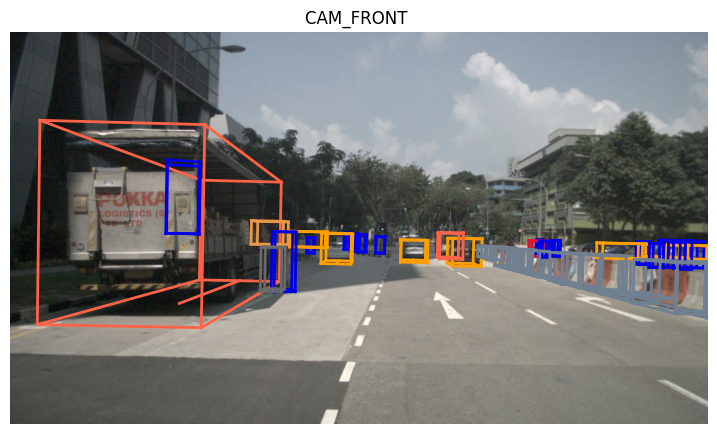

In [17]:
nusc.render_sample_data(cam_front_data['token'])

### 4. `sample_annotation`

`sample_annotation`은 샘플에서 본 ***객체의 위치를 정의하는 바운딩 박스***를 나타냅니다. 모든 위치 데이터는 전역 좌표 시스템을 기준으로 제공됩니다. 이제 위에서 언급한 `sample`에서 예제를 살펴보겠습니다.

In [18]:
my_annotation_token = my_sample['anns'][18] #first sample의 18th annotation
my_annotation_metadata =  nusc.get('sample_annotation', my_annotation_token)
my_annotation_metadata

{'token': '83d881a6b3d94ef3a3bc3b585cc514f8',
 'sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'instance_token': 'e91afa15647c4c4994f19aeb302c7179',
 'visibility_token': '4',
 'attribute_tokens': ['58aa28b1c2a54dc88e169808c07331e3'],
 'translation': [409.989, 1164.099, 1.623],
 'size': [2.877, 10.201, 3.595],
 'rotation': [-0.5828819500503033, 0.0, 0.0, 0.812556848660791],
 'prev': '',
 'next': 'f3721bdfd7ee4fd2a4f94874286df471',
 'num_lidar_pts': 495,
 'num_radar_pts': 13,
 'category_name': 'vehicle.truck'}

We can also render an annotation to have a closer look.

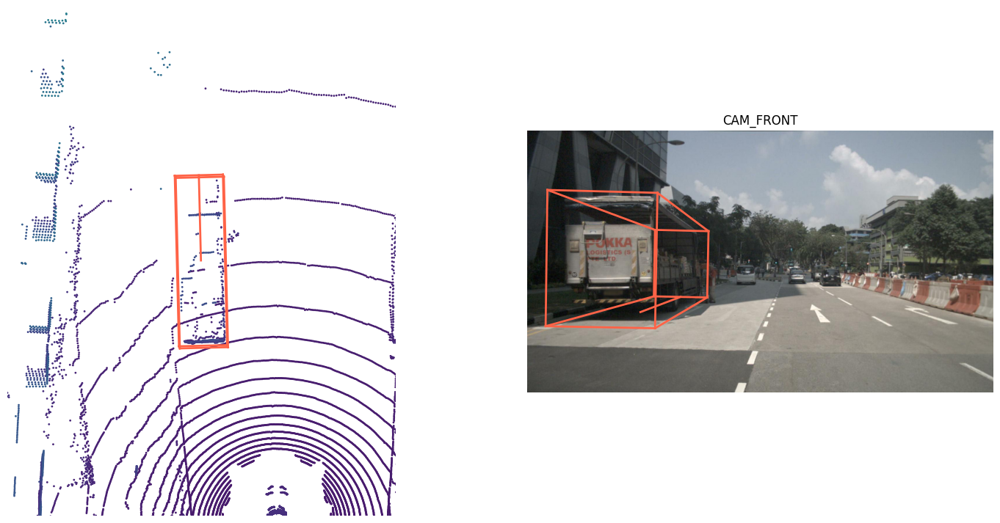

In [19]:
nusc.render_annotation(my_annotation_token)

### 5. `instance`

"Object instance"는 자율 주행 차량 (예: 특정 차량, 보행자)에서 감지하거나 추적해야 하는 인스턴스를 나타냅니다. 이제 인스턴스 메타데이터를 자세히 살펴보겠습니다.



In [13]:
my_instance = nusc.instance[599]
my_instance
#len(nusc.instance) = 911

{'token': '9cba9cd8af85487fb010652c90d845b5',
 'category_token': 'fedb11688db84088883945752e480c2c',
 'nbr_annotations': 16,
 'first_annotation_token': '77afa772cb4a4e5c8a5a53f2019bdba0',
 'last_annotation_token': '6fed6d902e5e487abb7444f62e1a2341'}

일반적으로 특정 장면 내에서는 객체 인스턴스를 여러 프레임에서 추적합니다. 그러나 다른 장면 간에는 이러한 추적을 수행하지 않습니다. 예를 들어, 특정 장면에서는 해당 인스턴스에 대해 16개의 주석이 달린 샘플이 있을 수 있습니다.

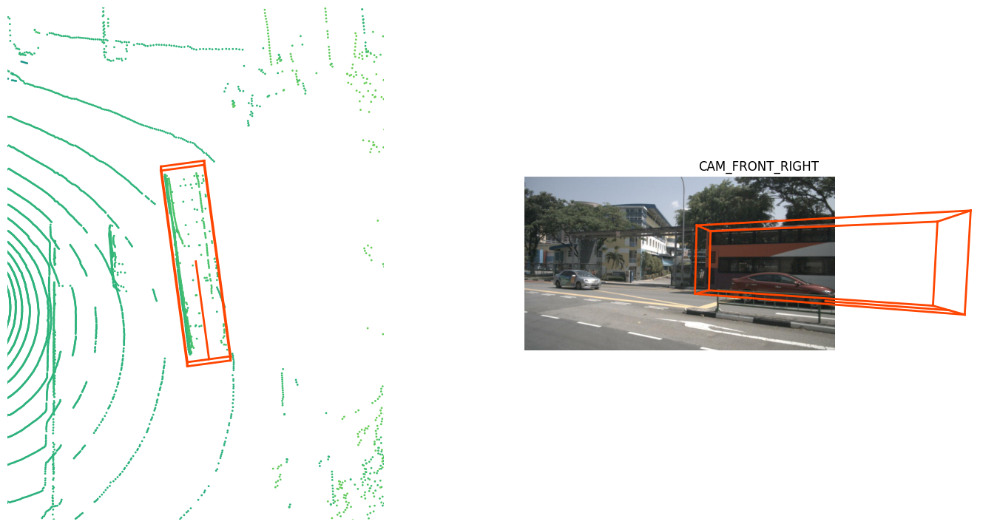

In [21]:
instance_token = my_instance['token'] #nusc.instance[i]['token']
nusc.render_instance(instance_token)

인스턴스 레코드는 해당 인스턴스의 첫 번째와 마지막 주석 토큰을 기록합니다

First annotated sample of this instance:


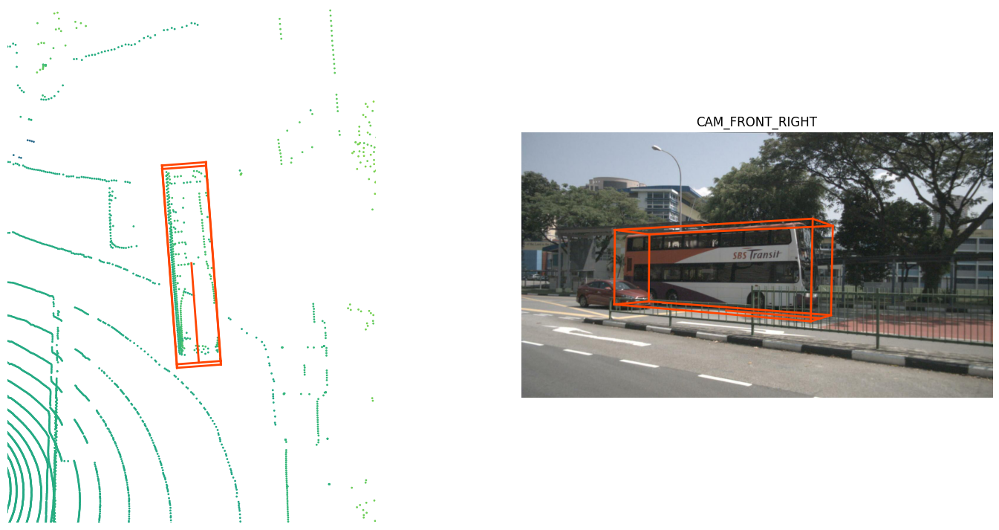

In [22]:
print("First annotated sample of this instance:")
nusc.render_annotation(my_instance['first_annotation_token'])

Last annotated sample of this instance


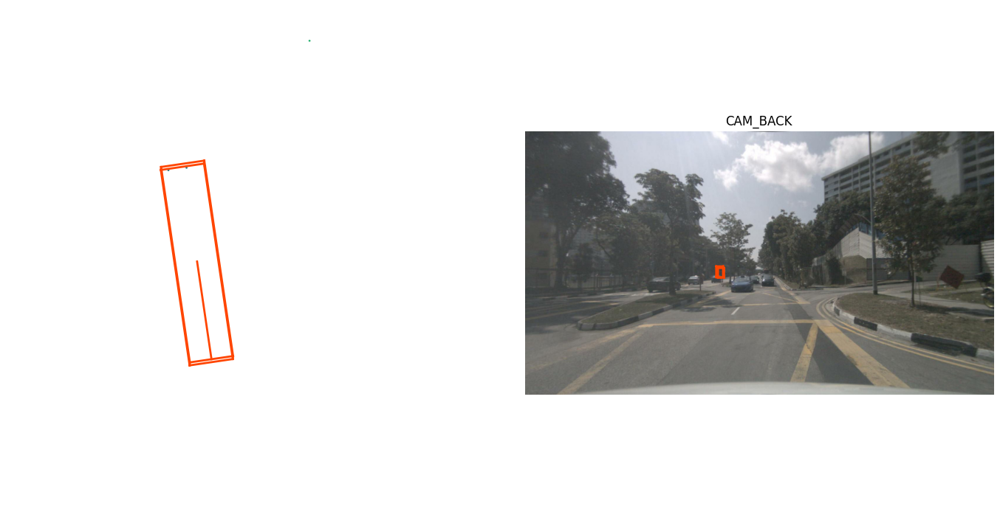

In [23]:
print("Last annotated sample of this instance")
nusc.render_annotation(my_instance['last_annotation_token'])

### 6. `category`

'category'는 주석의 객체 할당을 나타냅니다. 데이터베이스에 있는 카테고리 테이블을 살펴보면 다양한 객체 범주의 분류 및 하위 범주를 볼 수 있습니다. 이 테이블은 다양한 객체 범주의 계층 구조와 하위 범주를 나열하며, 하위 범주는 점으로 구분됩니다.

In [24]:
nusc.list_categories()

Category stats for split v1.0-mini:
human.pedestrian.adult      n= 4765, width= 0.68±0.11, len= 0.73±0.17, height= 1.76±0.12, lw_aspect= 1.08±0.23
human.pedestrian.child      n=   46, width= 0.46±0.08, len= 0.45±0.09, height= 1.37±0.06, lw_aspect= 0.97±0.05
human.pedestrian.constructi n=  193, width= 0.69±0.07, len= 0.74±0.12, height= 1.78±0.05, lw_aspect= 1.07±0.16
human.pedestrian.personal_m n=   25, width= 0.83±0.00, len= 1.28±0.00, height= 1.87±0.00, lw_aspect= 1.55±0.00
human.pedestrian.police_off n=   11, width= 0.59±0.00, len= 0.47±0.00, height= 1.81±0.00, lw_aspect= 0.80±0.00
movable_object.barrier      n= 2323, width= 2.32±0.49, len= 0.61±0.11, height= 1.06±0.10, lw_aspect= 0.28±0.09
movable_object.debris       n=   13, width= 0.43±0.00, len= 1.43±0.00, height= 0.46±0.00, lw_aspect= 3.35±0.00
movable_object.pushable_pul n=   82, width= 0.51±0.06, len= 0.79±0.10, height= 1.04±0.20, lw_aspect= 1.55±0.18
movable_object.trafficcone  n= 1378, width= 0.47±0.14, len= 0.45±0.07, heigh

카테고리 레코드는 특정 카테고리의 이름과 설명을 포함하고 있습니다.

In [16]:
nusc.category[9]
# len(nusc.category) = 23

{'token': 'dfd26f200ade4d24b540184e16050022',
 'name': 'vehicle.motorcycle',
 'description': 'Gasoline or electric powered 2-wheeled vehicle designed to move rapidly (at the speed of standard cars) on the road surface. This category includes all motorcycles, vespas and scooters.'}

다양한 카테고리의 정의에 대한 자세한 내용은 "instructions_nuscenes.md" 파일을 참조하십시오.

### 7. `attribute`

"속성(attribute)"은 객체 인스턴스의 속성으로, 카테고리는 동일한 상태를 유지하는 동안 장면의 다른 부분에서 변경될 수 있는 속성입니다. 여기서 제공된 속성과 해당 속성과 관련된 주석 수를 나열합니다.

In [26]:
nusc.list_attributes()

cycle.with_rider: 305
cycle.without_rider: 434
pedestrian.moving: 3875
pedestrian.sitting_lying_down: 111
pedestrian.standing: 1029
vehicle.moving: 2715
vehicle.parked: 4674
vehicle.stopped: 1545


한 장면에서 어떻게 속성이 변할 수 있는지에 대한 예제를 살펴보겠습니다

In [27]:
#여기는 잘 모르겠군
my_instance = nusc.instance[27]
first_token = my_instance['first_annotation_token']
last_token = my_instance['last_annotation_token']
nbr_samples = my_instance['nbr_annotations']
current_token = first_token

i = 0
found_change = False
while current_token != last_token:
    current_ann = nusc.get('sample_annotation', current_token)
    current_attr = nusc.get('attribute', current_ann['attribute_tokens'][0])['name']

    if i == 0:
        pass
    elif current_attr != last_attr:
        print("Changed from `{}` to `{}` at timestamp {} out of {} annotated timestamps".format(last_attr, current_attr, i, nbr_samples))
        found_change = True

    next_token = current_ann['next']
    current_token = next_token
    last_attr = current_attr
    i += 1

Changed from `pedestrian.moving` to `pedestrian.standing` at timestamp 21 out of 39 annotated timestamps


### 8. `visibility`

'visibility'는 특정 주석(annotation)의 픽셀 중 6개 카메라 피드에서 가시성이 있는 픽셀의 비율로 정의됩니다. 또한 이러한 가시성은 4개의 범주로 그룹화됩니다.

In [28]:
nusc.visibility

[{'description': 'visibility of whole object is between 0 and 40%',
  'token': '1',
  'level': 'v0-40'},
 {'description': 'visibility of whole object is between 40 and 60%',
  'token': '2',
  'level': 'v40-60'},
 {'description': 'visibility of whole object is between 60 and 80%',
  'token': '3',
  'level': 'v60-80'},
 {'description': 'visibility of whole object is between 80 and 100%',
  'token': '4',
  'level': 'v80-100'}]

Let's look at an example `sample_annotation` with 80-100% visibility

Visibility: {'description': 'visibility of whole object is between 80 and 100%', 'token': '4', 'level': 'v80-100'}


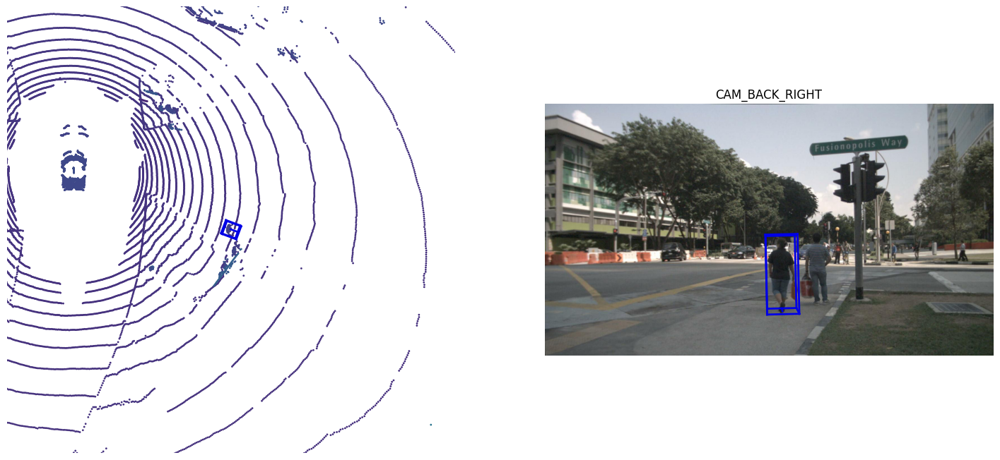

In [29]:
anntoken = 'a7d0722bce164f88adf03ada491ea0ba'
visibility_token = nusc.get('sample_annotation', anntoken)['visibility_token']

print("Visibility: {}".format(nusc.get('visibility', visibility_token)))
nusc.render_annotation(anntoken)

Let's look at an example `sample_annotation` with 0-40% visibility

Visibility: {'description': 'visibility of whole object is between 0 and 40%', 'token': '1', 'level': 'v0-40'}


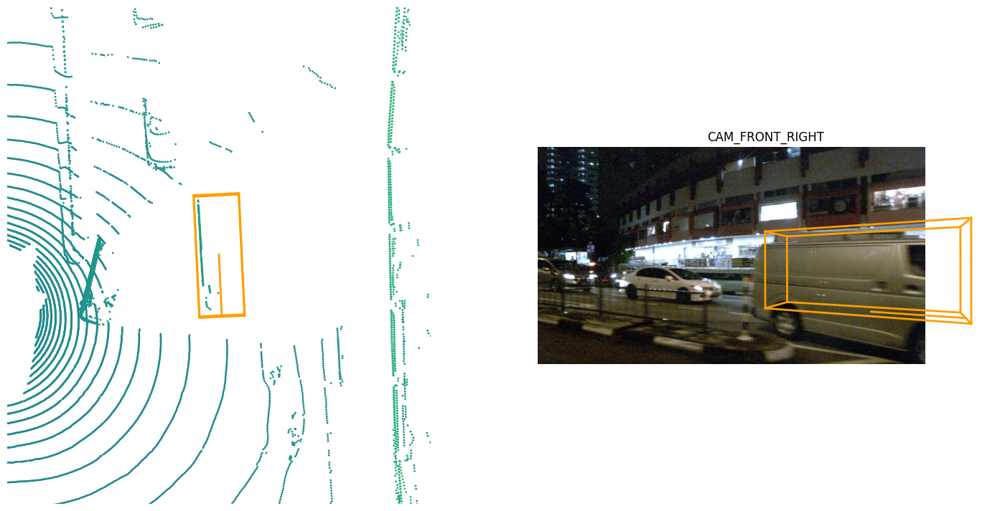

In [30]:
anntoken = '9f450bf6b7454551bbbc9a4c6e74ef2e'
visibility_token = nusc.get('sample_annotation', anntoken)['visibility_token']

print("Visibility: {}".format(nusc.get('visibility', visibility_token)))
nusc.render_annotation(anntoken)

### 9. `sensor`

NuScenes 데이터셋은 다음과 같은 전체 센서 스위트에서 수집된 데이터로 구성됩니다:
- 1 x LIDAR,
- 5 x RADAR,
- 6 x cameras,

In [31]:
nusc.sensor

[{'token': '725903f5b62f56118f4094b46a4470d8',
  'channel': 'CAM_FRONT',
  'modality': 'camera'},
 {'token': 'ce89d4f3050b5892b33b3d328c5e82a3',
  'channel': 'CAM_BACK',
  'modality': 'camera'},
 {'token': 'a89643a5de885c6486df2232dc954da2',
  'channel': 'CAM_BACK_LEFT',
  'modality': 'camera'},
 {'token': 'ec4b5d41840a509984f7ec36419d4c09',
  'channel': 'CAM_FRONT_LEFT',
  'modality': 'camera'},
 {'token': '2f7ad058f1ac5557bf321c7543758f43',
  'channel': 'CAM_FRONT_RIGHT',
  'modality': 'camera'},
 {'token': 'ca7dba2ec9f95951bbe67246f7f2c3f7',
  'channel': 'CAM_BACK_RIGHT',
  'modality': 'camera'},
 {'token': 'dc8b396651c05aedbb9cdaae573bb567',
  'channel': 'LIDAR_TOP',
  'modality': 'lidar'},
 {'token': '47fcd48f71d75e0da5c8c1704a9bfe0a',
  'channel': 'RADAR_FRONT',
  'modality': 'radar'},
 {'token': '232a6c4dc628532e81de1c57120876e9',
  'channel': 'RADAR_FRONT_RIGHT',
  'modality': 'radar'},
 {'token': '1f69f87a4e175e5ba1d03e2e6d9bcd27',
  'channel': 'RADAR_FRONT_LEFT',
  'modality'

각 sample_data에는 데이터가 수집된 sensor (센서)에 대한 레코드가 있으며, 이 정보는 "channel" 키를 통해 확인할 수 있습니다.

In [21]:
nusc.sample_data[10]
#len(nusc.sample_data)=31206

{'token': '2ecfec536d984fb491098c9db1404117',
 'sample_token': '356d81f38dd9473ba590f39e266f54e5',
 'ego_pose_token': '2ecfec536d984fb491098c9db1404117',
 'calibrated_sensor_token': 'f4d2a6c281f34a7eb8bb033d82321f79',
 'timestamp': 1532402928269133,
 'fileformat': 'pcd',
 'is_key_frame': False,
 'height': 0,
 'width': 0,
 'filename': 'sweeps/RADAR_FRONT/n015-2018-07-24-11-22-45+0800__RADAR_FRONT__1532402928269133.pcd',
 'prev': 'b933bbcb4ee84a7eae16e567301e1df2',
 'next': '79ef24d1eba84f5abaeaf76655ef1036',
 'sensor_modality': 'radar',
 'channel': 'RADAR_FRONT'}

### 10. `calibrated_sensor`

calibrated_sensor는 특정 차량 상에서 보정된 특정 센서 (lidar, radar, camera)의 정의를 포함하고 있습니다. Let us look at an example.

In [23]:
nusc.calibrated_sensor[0]
#len(nusc.calibrated_sensor)=120

{'token': 'f4d2a6c281f34a7eb8bb033d82321f79',
 'sensor_token': '47fcd48f71d75e0da5c8c1704a9bfe0a',
 'translation': [3.412, 0.0, 0.5],
 'rotation': [0.9999984769132877, 0.0, 0.0, 0.0017453283658983088],
 'camera_intrinsic': []}

calibrated_sensor의 translation 및 rotation 매개변수는 주체 차량의 차체(body) 프레임을 기준으로 제공됩니다.

### 11. `ego_pose`

'ego_pose'에는 주체 차량의 위치 (translation으로 인코딩) 및 방향 (rotation으로 인코딩) 정보가 포함되어 있습니다. 이 정보는 전역 좌표 시스템을 기준으로 주체 차량의 위치와 방향을 정확하게 나타냅니다. 

In [25]:
nusc.ego_pose[0]
#len(nusc.ego_pose)=31206 
#nusc.sample_data랑 len 똑같음 

{'token': '5ace90b379af485b9dcb1584b01e7212',
 'timestamp': 1532402927814384,
 'rotation': [0.5731787718287827,
  -0.0015811634307974854,
  0.013859363182046986,
  -0.8193116095230444],
 'translation': [410.77878632230204, 1179.4673290964536, 0.0]}

Note that the number of `ego_pose` records in our loaded database is the same as the number of `sample_data` records. These two records exhibit a one-to-one correspondence.

### 12. `log`

log 테이블에는 데이터가 추출된 로그 정보가 포함되어 있습니다. log 레코드는 우리 주체 차량이 미리 정의된 경로를 따라 이루어진 하나의 여정을 나타냅니다. 로그의 수와 로그의 메타데이터를 확인해 보겠습니다.

In [35]:
print("Number of `logs` in our loaded database: {}".format(len(nusc.log)))

Number of `logs` in our loaded database: 8


In [27]:
nusc.log[0]
#len(nusc.log)=8

{'token': '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
 'logfile': 'n015-2018-07-24-11-22-45+0800',
 'vehicle': 'n015',
 'date_captured': '2018-07-24',
 'location': 'singapore-onenorth',
 'map_token': '53992ee3023e5494b90c316c183be829'}

이것은 로그가 수집된 날짜와 위치와 같은 다양한 정보를 포함하고 있음을 알려줍니다. 또한 데이터가 수집된 지도에 관한 정보도 제공합니다. 한 로그에는 중첩되지 않는 여러 장면(scene)이 포함될 수 있다는 점에 유의하십시오.

### 13. `map`

지도 정보는 위에서 아래로 바라본 시각으로 저장된 이진 의미론적 마스크(binary semantic masks)로 저장됩니다. 이제 지도의 수와 지도의 메타데이터를 확인해 보겠습니다.

In [37]:
print("There are {} maps masks in the loaded dataset".format(len(nusc.map)))

There are 4 maps masks in the loaded dataset


In [38]:
nusc.map[0]

{'category': 'semantic_prior',
 'token': '53992ee3023e5494b90c316c183be829',
 'filename': 'maps/53992ee3023e5494b90c316c183be829.png',
 'log_tokens': ['0986cb758b1d43fdaa051ab23d45582b',
  '1c9b302455ff44a9a290c372b31aa3ce',
  'e60234ec7c324789ac7c8441a5e49731',
  '46123a03f41e4657adc82ed9ddbe0ba2',
  'a5bb7f9dd1884f1ea0de299caefe7ef4',
  'bc41a49366734ebf978d6a71981537dc',
  'f8699afb7a2247e38549e4d250b4581b',
  'd0450edaed4a46f898403f45fa9e5f0d',
  'f38ef5a1e9c941aabb2155768670b92a',
  '7e25a2c8ea1f41c5b0da1e69ecfa71a2',
  'ddc03471df3e4c9bb9663629a4097743',
  '31e9939f05c1485b88a8f68ad2cf9fa4',
  '783683d957054175bda1b326453a13f4',
  '343d984344e440c7952d1e403b572b2a',
  '92af2609d31445e5a71b2d895376fed6',
  '47620afea3c443f6a761e885273cb531',
  'd31dc715d1c34b99bd5afb0e3aea26ed',
  '34d0574ea8f340179c82162c6ac069bc',
  'd7fd2bb9696d43af901326664e42340b',
  'b5622d4dcb0d4549b813b3ffb96fbdc9',
  'da04ae0b72024818a6219d8dd138ea4b',
  '6b6513e6c8384cec88775cae30b78c0e',
  'eda311bda86f

## nuScenes Basics

Let's get a bit technical.

NuScenes 클래스는 여러 테이블을 보유하고 있습니다. 각 테이블은 레코드(record)의 목록이며, 각 레코드는 딕셔너리 형태로 구성됩니다. 예를 들어, 카테고리 테이블의 첫 번째 레코드는 다음 경로에 저장되어 있습니다:

In [39]:
nusc.category[0]

{'token': '1fa93b757fc74fb197cdd60001ad8abf',
 'name': 'human.pedestrian.adult',
 'description': 'Adult subcategory.'}

카테고리 테이블은 간단하게 name과 description 필드를 가지고 있습니다. 또한 고유한 레코드 식별자인 token 필드도 있습니다. 레코드가 딕셔너리 형태로 구성되어 있으므로 token에 접근하려면 다음과 같이 할 수 있습니다:

In [40]:
cat_token = nusc.category[0]['token']
cat_token

'1fa93b757fc74fb197cdd60001ad8abf'

데이터베이스에서 레코드의 token을 알고 있다면 다음과 같이 해당 레코드를 검색할 수 있습니다:

In [41]:
nusc.get('category', cat_token)

{'token': '1fa93b757fc74fb197cdd60001ad8abf',
 'name': 'human.pedestrian.adult',
 'description': 'Adult subcategory.'}

_As you can notice, we have recovered the same record!_

더 복잡한 내용을 살펴보겠습니다. sample_annotation 테이블을 확인해 보겠습니다.

In [42]:
nusc.sample_annotation[0]

{'token': '70aecbe9b64f4722ab3c230391a3beb8',
 'sample_token': 'cd21dbfc3bd749c7b10a5c42562e0c42',
 'instance_token': '6dd2cbf4c24b4caeb625035869bca7b5',
 'visibility_token': '4',
 'attribute_tokens': ['4d8821270b4a47e3a8a300cbec48188e'],
 'translation': [373.214, 1130.48, 1.25],
 'size': [0.621, 0.669, 1.642],
 'rotation': [0.9831098797903927, 0.0, 0.0, -0.18301629506281616],
 'prev': 'a1721876c0944cdd92ebc3c75d55d693',
 'next': '1e8e35d365a441a18dd5503a0ee1c208',
 'num_lidar_pts': 5,
 'num_radar_pts': 0,
 'category_name': 'human.pedestrian.adult'}

`sample_annotation` 테이블 또한 `token` 필드를 가지고 있습니다. 더불어, [a-z]*\_token 형식의 여러 필드가 있으며, 데이터베이스 용어로는 외래 키(foreign keys)라고 합니다. 이 외래 키는 다른 테이블을 가리키는 역할을 하며, `nusc.get()`을 사용하면 상수 시간 안에 이러한 값을 가져올 수 있습니다. 예를 들어, 가시성(visibility) 레코드를 살펴보겠습니다.

In [43]:
nusc.get('visibility', nusc.sample_annotation[0]['visibility_token'])

{'description': 'visibility of whole object is between 80 and 100%',
 'token': '4',
 'level': 'v80-100'}

가시성(visibility) 레코드는 주석(annotation)이 작성될 때 객체가 얼마나 가시적이었는지를 나타냅니다.

또한 instance_token도 함께 가져오려면 다음과 같이 진행할 수 있습니다.

In [44]:
one_instance = nusc.get('instance', nusc.sample_annotation[0]['instance_token'])
one_instance

{'token': '6dd2cbf4c24b4caeb625035869bca7b5',
 'category_token': '1fa93b757fc74fb197cdd60001ad8abf',
 'nbr_annotations': 39,
 'first_annotation_token': 'ef63a697930c4b20a6b9791f423351da',
 'last_annotation_token': '8bb63134d48840aaa2993f490855ff0d'}

instance_token은 'instance' 테이블을 가리킵니다. 이 테이블은 각 장면(scene)에서 만난 객체 인스턴스를 열거합니다. 이렇게 하면 특정 객체의 모든 주석(annotation)을 연결할 수 있습니다.

README 테이블을 주의 깊게 살펴보면 sample_annotation 테이블이 instance 테이블을 가리키지만 instance 테이블이 자신을 가리키는 모든 주석을 나열하지 않음을 알 수 있습니다.

그러면 어떻게 특정 객체 인스턴스에 대한 모든 sample_annotation을 복구할 수 있을까요? 두 가지 방법이 있습니다:

1. `Use nusc.field2token()`. Let's try it:

In [45]:
ann_tokens = nusc.field2token('sample_annotation', 'instance_token', one_instance['token'])

이것은 `'instance_token'` == `one_instance['token']`인 같은 모든 sample_annotation 레코드의 목록을 반환합니다. 일단 이들을 세트에 저장해 둡시다.

In [46]:
ann_tokens_field2token = set(ann_tokens)

ann_tokens_field2token

{'05e0ad1194804f548be544f2267c7e74',
 '060be69422ee4b2a8b239b463b995e92',
 '146b2111cc0c401ca09d96777758d81e',
 '163d85048698495dbf55a35f613c5fb9',
 '17a6843fefcd4b2b811eddbb1ccd708d',
 '1de9ad564050444486eb587360cf135f',
 '1e8e35d365a441a18dd5503a0ee1c208',
 '23f10d5f0d254068941be8797493c7eb',
 '2b5948828cdb49e3be6be1320381bbbf',
 '3a930d1793434d9a8a87d6eba28ff70e',
 '3b24f083c0bf42d695a1040efdab7ffe',
 '4e41d9560dbf46cab1568b8ef6a282f3',
 '6f371d3f0d7d494eaa6f81daa3df58c0',
 '70aecbe9b64f4722ab3c230391a3beb8',
 '74f550e3257c4f52af1102c0d49d37b8',
 '7670ac8bc5044d5a9e11e205c839385d',
 '794fcc425f074a1392206ed925fdbbd8',
 '7987617983634b119e383d8a29607fd7',
 '7fa3a688931b4500b7ce29d187d3b975',
 '807b3e029a6b4e428f6cc82fc26a35a7',
 '8bb63134d48840aaa2993f490855ff0d',
 '90d94112b9ea4fb691e988b40af5b161',
 '913072e56d6c4025b9b47ba085dd6d7c',
 '93d5b79041c64693a5b32f1103a39a06',
 '9acb7dfed3454f72b2874dda3bdacc48',
 'a1721876c0944cdd92ebc3c75d55d693',
 'a2b20cdbf1ed4018ac795b8845d5deaa',
 

The `nusc.field2token()` method is generic and can be used in any similar situation.

2. For certain situation, we provide some reverse indices in the tables themselves. This is one such example.

The instance record has a field `first_annotation_token` which points to the first annotation in time of this instance.
Recovering this record is easy.

In [47]:
ann_record = nusc.get('sample_annotation', one_instance['first_annotation_token'])
ann_record

{'token': 'ef63a697930c4b20a6b9791f423351da',
 'sample_token': 'ca9a282c9e77460f8360f564131a8af5',
 'instance_token': '6dd2cbf4c24b4caeb625035869bca7b5',
 'visibility_token': '1',
 'attribute_tokens': ['4d8821270b4a47e3a8a300cbec48188e'],
 'translation': [373.256, 1130.419, 0.8],
 'size': [0.621, 0.669, 1.642],
 'rotation': [0.9831098797903927, 0.0, 0.0, -0.18301629506281616],
 'prev': '',
 'next': '7987617983634b119e383d8a29607fd7',
 'num_lidar_pts': 1,
 'num_radar_pts': 0,
 'category_name': 'human.pedestrian.adult'}

Now we can traverse all annotations of this instance using the "next" field. Let's try it.

In [48]:
ann_tokens_traverse = set()
ann_tokens_traverse.add(ann_record['token'])
while not ann_record['next'] == "":
    ann_record = nusc.get('sample_annotation', ann_record['next'])
    ann_tokens_traverse.add(ann_record['token'])

Finally, let's assert that we recovered the same ann_records as we did using nusc.field2token:

In [49]:
print(ann_tokens_traverse == ann_tokens_field2token)

True


## Reverse indexing and short-cuts

The nuScenes tables are normalized, meaning that each piece of information is only given once.
For example, there is one `map` record for each `log` record. Looking at the schema you will notice that the `map` table has a `log_token` field, but that the `log` table does not have a corresponding `map_token` field. But there are plenty of situations where you have a `log`, and want to find the corresponding `map`! So what to do? You can always use the `nusc.field2token()` method, but that is slow and inconvenient. We therefore add reverse mappings for some common situations including this one.

Further, there are situations where one needs to go through several tables to get a certain piece of information.
Consider, for example, the category name (e.g. `human.pedestrian`) of a `sample_annotation`. The `sample_annotation` table doesn't hold this information since the category is an instance level constant. Instead the `sample_annotation` table points to a record in the `instance` table. This, in turn, points to a record in the `category` table, where finally the `name` fields stores the required information.

Since it is quite common to want to know the category name of an annotation, we add a `category_name` field to the `sample_annotation` table during initialization of the NuScenes class.

In this section, we list the short-cuts and reverse indices that are added to the `NuScenes` class during initialization. These are all created in the `NuScenes.__make_reverse_index__()` method.

### Reverse indices
We add two reverse indices by default.
* A `map_token` field is added to the `log` records.
* The `sample` records have shortcuts to all `sample_annotations` for that record as well as `sample_data` key-frames. Confer `nusc.list_sample()` method in the previous section for more details on this.

### Shortcuts

The sample_annotation table has a "category_name" shortcut.

_Using shortcut:_

In [50]:
catname = nusc.sample_annotation[0]['category_name']

_Not using shortcut:_

In [51]:
ann_rec = nusc.sample_annotation[0]
inst_rec = nusc.get('instance', ann_rec['instance_token'])
cat_rec = nusc.get('category', inst_rec['category_token'])

print(catname == cat_rec['name'])

True


The sample_data table has "channel" and "sensor_modality" shortcuts:

In [52]:
# Shortcut
channel = nusc.sample_data[0]['channel']

# No shortcut
sd_rec = nusc.sample_data[0]
cs_record = nusc.get('calibrated_sensor', sd_rec['calibrated_sensor_token'])
sensor_record = nusc.get('sensor', cs_record['sensor_token'])

print(channel == sensor_record['channel'])

True


## Data Visualizations

우리는 목록 및 렌더링 메서드를 제공합니다. 이러한 메서드는 개발 중에 편리한 도구로 사용되고, 자체 시각화 메서드를 작성하기 위한 자습서로 사용됩니다. 이러한 메서드는 NuScenesExplorer 클래스에 구현되어 있으며 NuScenes 클래스 자체를 통해 바로가기로 사용할 수 있습니다.

### List methods
There are three list methods available.

1. `list_categories()` 메서드는 모든 카테고리의 목록, 개수 및 미터 단위로 width/length/height 및 종횡비에 대한 통계를 나열합니다. 이 메서드를 사용하면 데이터셋 내의 객체 카테고리와 해당 카테고리에 대한 크기 및 특성에 대한 정보를 확인할 수 있습니다.

In [53]:
nusc.list_categories()

Category stats for split v1.0-mini:
human.pedestrian.adult      n= 4765, width= 0.68±0.11, len= 0.73±0.17, height= 1.76±0.12, lw_aspect= 1.08±0.23
human.pedestrian.child      n=   46, width= 0.46±0.08, len= 0.45±0.09, height= 1.37±0.06, lw_aspect= 0.97±0.05
human.pedestrian.constructi n=  193, width= 0.69±0.07, len= 0.74±0.12, height= 1.78±0.05, lw_aspect= 1.07±0.16
human.pedestrian.personal_m n=   25, width= 0.83±0.00, len= 1.28±0.00, height= 1.87±0.00, lw_aspect= 1.55±0.00
human.pedestrian.police_off n=   11, width= 0.59±0.00, len= 0.47±0.00, height= 1.81±0.00, lw_aspect= 0.80±0.00
movable_object.barrier      n= 2323, width= 2.32±0.49, len= 0.61±0.11, height= 1.06±0.10, lw_aspect= 0.28±0.09
movable_object.debris       n=   13, width= 0.43±0.00, len= 1.43±0.00, height= 0.46±0.00, lw_aspect= 3.35±0.00
movable_object.pushable_pul n=   82, width= 0.51±0.06, len= 0.79±0.10, height= 1.04±0.20, lw_aspect= 1.55±0.18
movable_object.trafficcone  n= 1378, width= 0.47±0.14, len= 0.45±0.07, heigh

2. `list_attributes()` lists all attributes and counts.

In [54]:
nusc.list_attributes()

cycle.with_rider: 305
cycle.without_rider: 434
pedestrian.moving: 3875
pedestrian.sitting_lying_down: 111
pedestrian.standing: 1029
vehicle.moving: 2715
vehicle.parked: 4674
vehicle.stopped: 1545


3. `list_scenes()` lists all scenes in the loaded DB.

In [55]:
nusc.list_scenes()

scene-0061, Parked truck, construction, intersectio... [18-07-24 03:28:47]   19s, singapore-onenorth, #anns:4622
scene-0103, Many peds right, wait for turning car, ... [18-08-01 19:26:43]   19s, boston-seaport, #anns:2046
scene-0655, Parking lot, parked cars, jaywalker, be... [18-08-27 15:51:32]   20s, boston-seaport, #anns:2332
scene-0553, Wait at intersection, bicycle, large tr... [18-08-28 20:48:16]   20s, boston-seaport, #anns:1950
scene-0757, Arrive at busy intersection, bus, wait ... [18-08-30 19:25:08]   20s, boston-seaport, #anns:592
scene-0796, Scooter, peds on sidewalk, bus, cars, t... [18-10-02 02:52:24]   20s, singapore-queensto, #anns:708
scene-0916, Parking lot, bicycle rack, parked bicyc... [18-10-08 07:37:13]   20s, singapore-queensto, #anns:2387
scene-1077, Night, big street, bus stop, high speed... [18-11-21 11:39:27]   20s, singapore-hollandv, #anns:890
scene-1094, Night, after rain, many peds, PMD, ped ... [18-11-21 11:47:27]   19s, singapore-hollandv, #anns:1762
sc

### Render

먼저 이미지에서 LIDAR(라이다) 포인트 클라우드를 플롯해 보겠습니다. LIDAR를 사용하면 주변 환경을 정확하게 3D로 매핑할 수 있습니다.

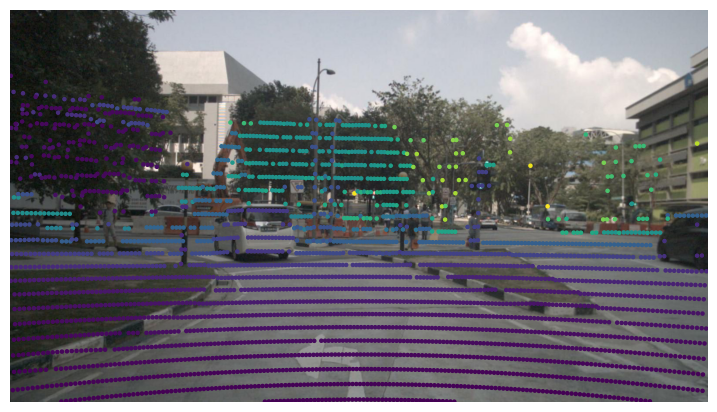

In [56]:
my_sample = nusc.sample[10]
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='LIDAR_TOP')

이전 이미지에서 색상은 주체 차량에서 각 LIDAR 포인트까지의 거리를 나타냅니다. 또한 LIDAR 강도를 렌더링할 수도 있습니다. 다음 이미지에서는 우리 앞의 교통 신호가 높은 반사율(노란색)을 가지고 있고, 오른쪽에 있는 어두운 차량은 낮은 반사율(보라색)을 가지고 있음을 볼 수 있습니다.

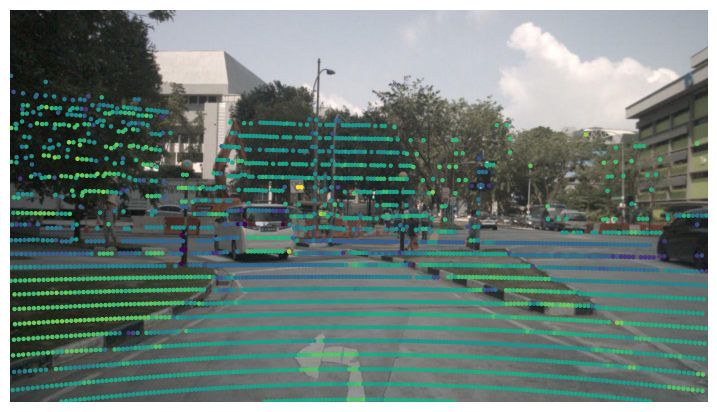

In [57]:
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='LIDAR_TOP', render_intensity=True)

두 번째로, 동일한 이미지에 대한 레이더 포인트 클라우드를 그려보겠습니다. 레이더는 라이다보다 밀도가 낮지만 훨씬 큰 범위를 가지고 있습니다.

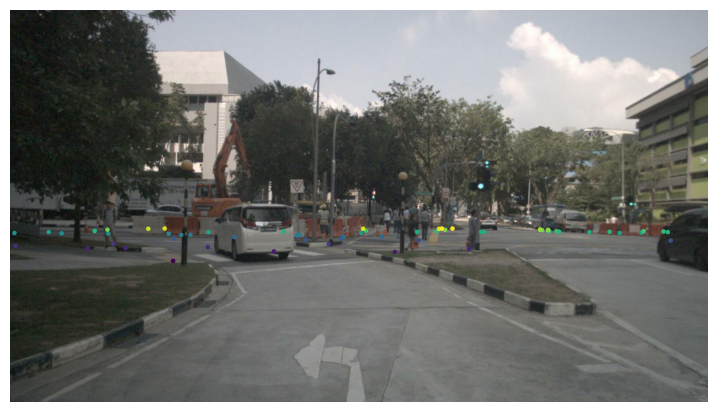

In [58]:
nusc.render_pointcloud_in_image(my_sample['token'], pointsensor_channel='RADAR_FRONT')

해당 샘플에 대한 모든 샘플 데이터를 통해 모든 주석(annotation)을 그릴 수도 있습니다. 레이더의 경우 이동 중인 객체의 속도 벡터(velocity vector)도 그릴 수 있습니다. 일부 속도 벡터는 이상치(outliers)일 수 있으며, RadarPointCloud.from_file()의 설정을 사용하여 필터링할 수 있습니다.

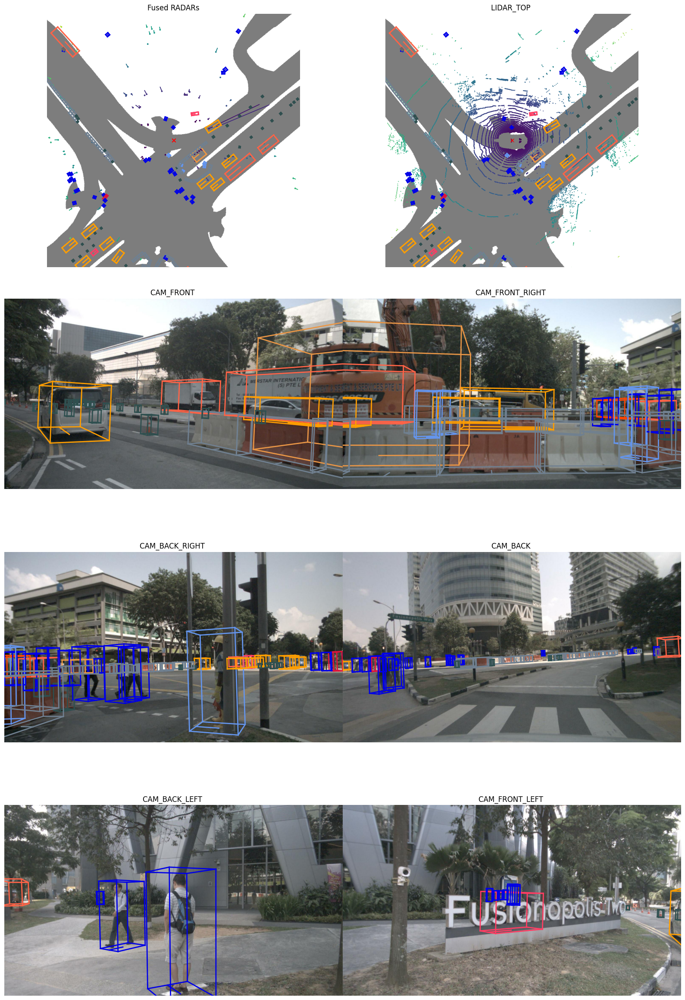

In [28]:
my_sample = nusc.sample[20]

# The rendering command below is commented out because it may crash in notebooks
nusc.render_sample(my_sample['token'])

특정 센서만 렌더링하고자 하는 경우 해당 센서를 지정할 수 있습니다. 

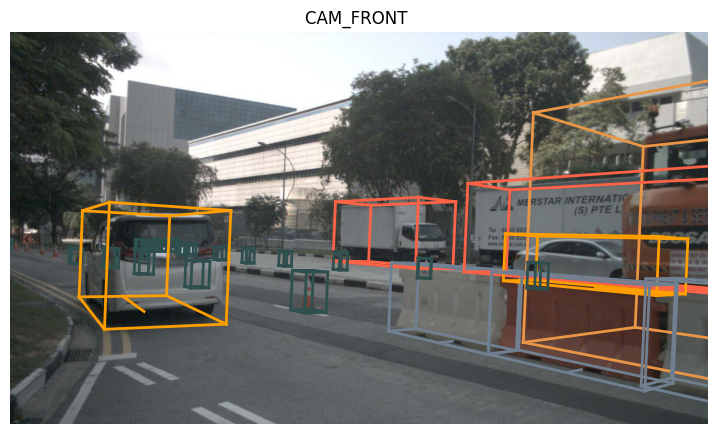

In [60]:
nusc.render_sample_data(my_sample['data']['CAM_FRONT'])

또한 여러 번의 스위핑(sweeping)에서 포인트 클라우드를 집계하여 보다 밀도가 높은 포인트 클라우드를 얻을 수 있습니다.

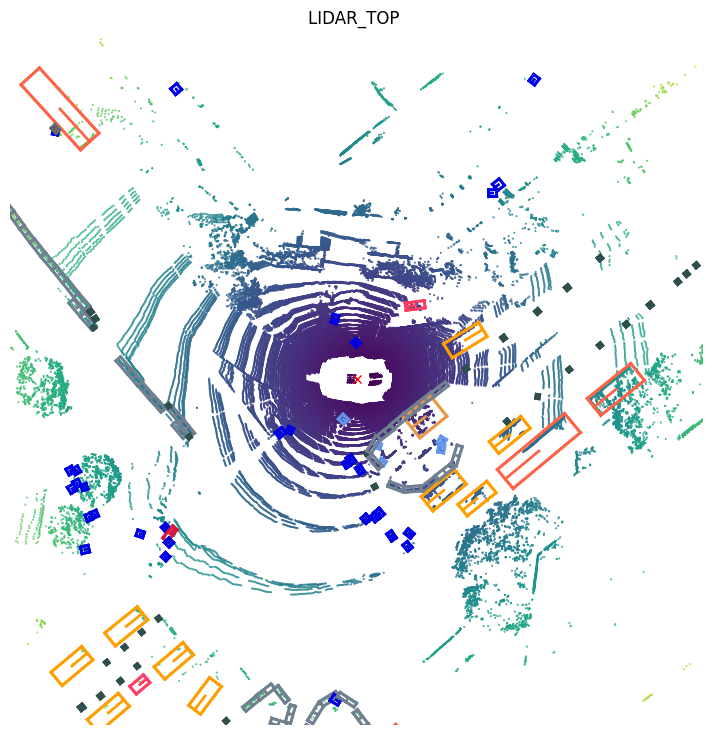

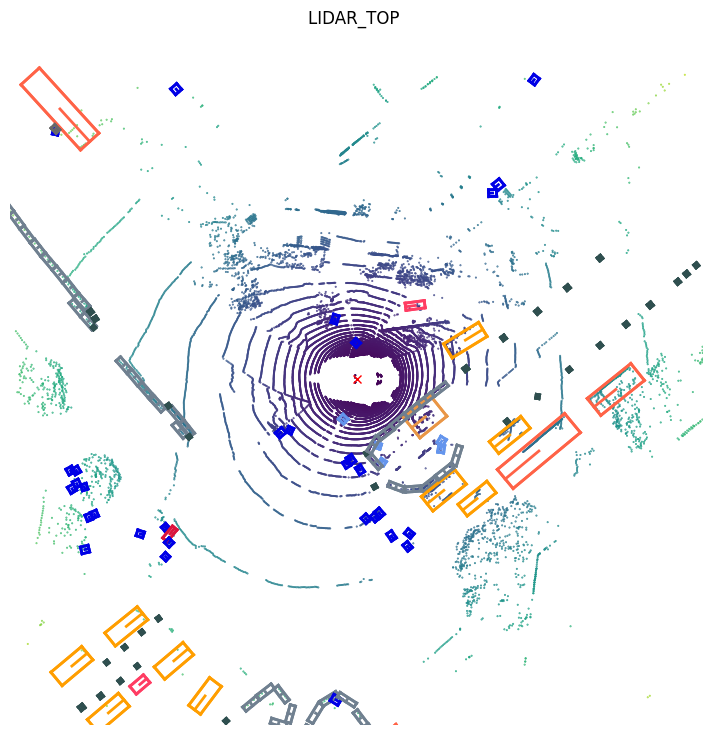

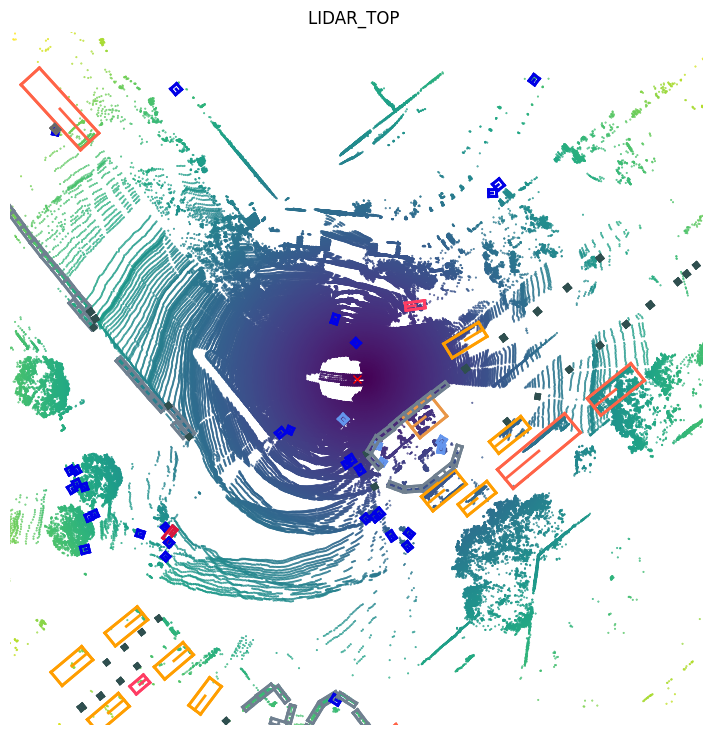

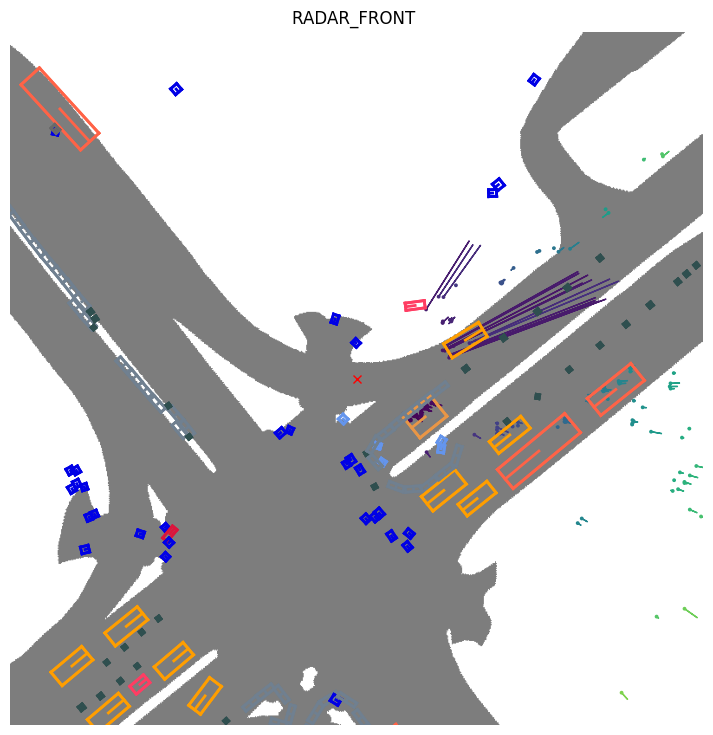

In [32]:
nusc.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=5, underlay_map=False)
nusc.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=1, underlay_map=False)
nusc.render_sample_data(my_sample['data']['LIDAR_TOP'], nsweeps=20, underlay_map=False)
nusc.render_sample_data(my_sample['data']['RADAR_FRONT'], nsweeps=5, underlay_map=True)

위의 radar 플롯에서는 두 대의 차량에서만 매우 확신 있는 레이더 반환(return)을 볼 수 있습니다. 이것은 nuscenes/utils/data_classes.py 파일에서 정의된 필터 설정 때문입니다. 대신, 모든 필터를 비활성화하고 모든 반환을 렌더링하려면 disable_filters() 함수를 사용할 수 있습니다. 이렇게 하면 보다 밀도가 높은 포인트 클라우드가 생성되지만, 배경 객체로부터의 많은 반환(return)도 포함될 수 있습니다. 기본 설정으로 돌아가려면 간단히 default_filters()를 호출하면 됩니다.`.

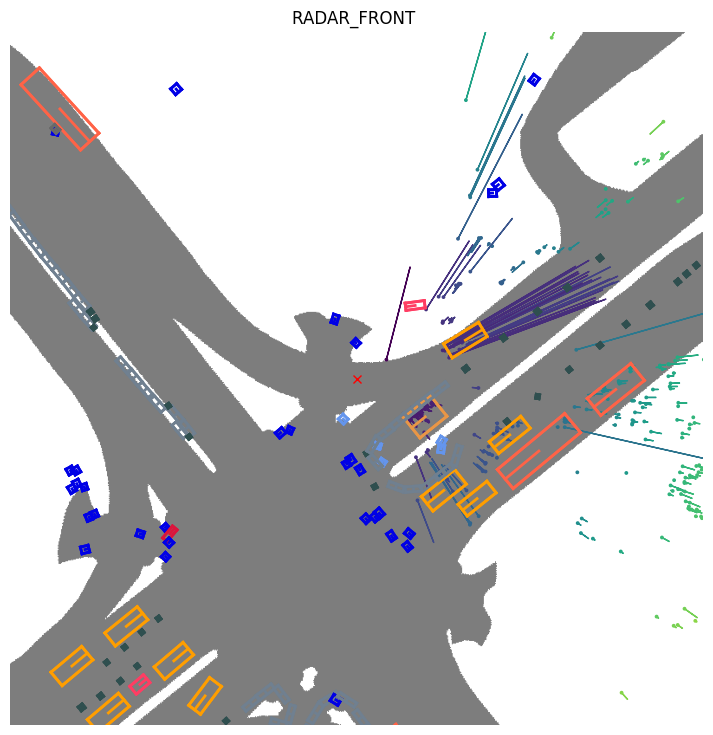

In [62]:
from nuscenes.utils.data_classes import RadarPointCloud
RadarPointCloud.disable_filters()
nusc.render_sample_data(my_sample['data']['RADAR_FRONT'], nsweeps=5, underlay_map=True)
RadarPointCloud.default_filters()

특정 주석(annotation)을 렌더링할 수도 있습니다. 

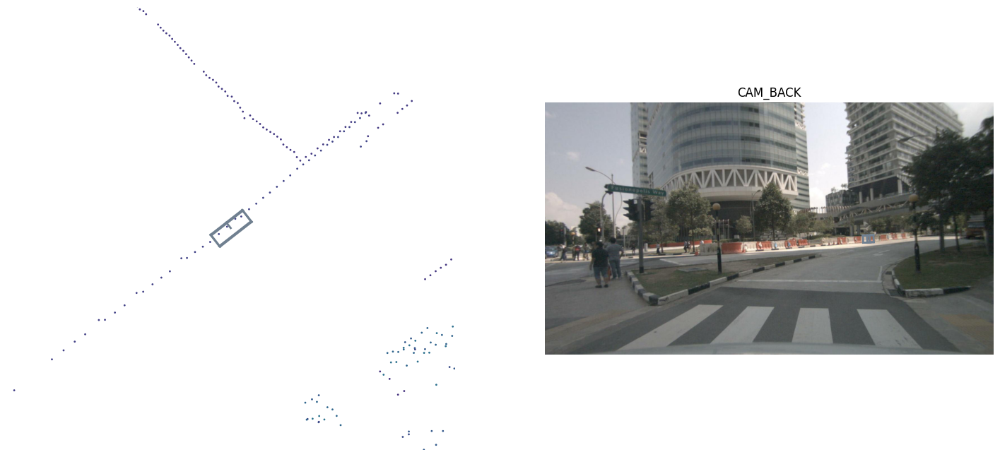

In [63]:
nusc.render_annotation(my_sample['anns'][22])

마지막으로, 전체 장면을 비디오로 렌더링할 수도 있습니다. 여기에는 두 가지 옵션이 있습니다.
1. nusc.render_scene_channel()은 특정 채널에 대한 비디오를 렌더링합니다. (종료하려면 ESC 키를 누르세요)
2. nusc.render_scene()은 모든 카메라 채널에 대한 비디오를 렌더링합니다.

참고: 이러한 메서드는 렌더링에 OpenCV를 사용하며, IPython Notebook과 호환되지 않을 수 있습니다. 문제가 발생하는 경우 명령 프롬프트에서 이러한 코드를 실행하십시오.

"scene 0061"을 가져와서 해당 장면을 렌더링해 보겠습니다. 이 장면은 밀도가 높고 시각적으로 풍부한 장면입니다.

In [34]:
my_scene_token = nusc.field2token('scene', 'name', 'scene-0061')[0]

In [35]:
#  The rendering command below is commented out because it may crash in notebooks
nusc.render_scene_channel(my_scene_token, 'CAM_FRONT')

There is also a method nusc.render_scene() which renders the video for all camera channels.
This requires a high-res monitor, and is also best run outside this notebook.

In [1]:
## 약간 렉
# The rendering command below is commented out because it may crash in notebooks
# nusc.render_scene(my_scene_token)

Finally, let us visualize all scenes on the map for a particular location.

In [2]:
nusc.render_egoposes_on_map(log_location='singapore-onenorth')

NameError: name 'nusc' is not defined